# Example for rigid alignment with object oriented lib

## Git clone and package installation

First, you will need to git clone this repo as follows:
1. `git clone https://github.com/donglaiw/ExM-Toolbox/tree/jack` (i.e. not branch main!)
Then, checkout branch jack
2. `cd ExM-Toolbox`
3. `git checkout jack`
Now, install package as described in the `README.md`, make sure you are installing things properly, often times my python path is messed up, getting the path to your conda env via 
`conda info --envs` and running `/path/to/your/conda/env/bin/pip install -r requirements.txt --editable .` (make sure you are in ExM-Toolbox when you run this!)



# Library walkthrough

The general structure can be seen below. Note certain modules like Runner and Dataset not all that built out but rather place holders for modules that would be good to include (in Jack's opinion). Most of the development has been happening on the `align` side of things.

![title](../lib_struc.png)

## config

In elementary school the earliest exposure I have ever had to reproducibility was the [peanut butter and jelly experiment](https://www.youtube.com/watch?v=Ct-lOOUqmyY). A similar thing can be said of scientific computing, the Dad is another scientist that would like to use our technology on our own sample. If our instructions are not rigid, explicit, and robust, then the experiment will not be reproducible and who's to claim what we discovered is real. In computing this ususally comes down to parameters, to avoid overwriting parameters, or writing parameters to a global variable that we forget about, we can simply use a configuration file like below. 

In [1]:
from exm.config.utils import load_cfg
import json

cfg = load_cfg()

pretty_cfg = json.dumps(cfg, indent = 4)

print(pretty_cfg)

{
    "SYSTEM": {},
    "ALIGN": {
        "RESOLUTION": [
            1.625,
            1.625,
            4.0
        ],
        "TRANSFORM_TYPE": [
            "rigid"
        ],
        "TYPE": "intensity",
        "NumberOfSamplesForExactGradient": "100000",
        "MaximumNumberOfIterations": "2000",
        "MaximumNumberOfSamplingAttempts": "100",
        "FinalBSplineInterpolationOrder": "1",
        "NumberOfIterations": 10000,
        "InitialRadius": 0.000625,
        "Epsilon": 0.00015,
        "ShrinkFactors": [
            4,
            2,
            1
        ],
        "SmoothingSigmas": [
            2,
            1,
            0
        ],
        "MetricSamplingPercentage": 0.01,
        "MetricSamplingStrategy": 2,
        "NumberOfHistogramBins": 50,
        "Interpolator": 2
    },
    "DATASET": {
        "VOL_FIX_PATH": "path/to/vol_fix",
        "VOL_MOVE_PATH": "path/to/vol_move",
        "OUTPUT_PATH": "path/to/out_path",
        "ITER_AXES": "v",
    

What this now gives us is a reproducbile set of parameters that anyone can copy and use to get the same results we did. Furthermore as our technologies become developed people can edit these configurations, then distribute them to the general public in a coherent and accessible manner. We will use this cfg dictionary and it's contents throughout the tutorial.

## align

This is the module that hosts all the code that we use to interface with SimpleITK, the python library that allows us to do rigid registration. For this example lets just consider the `sitkTile` object. 

In [2]:
from exm.align.sitk_tile import sitkTile

# init obj, must pass cfg
sitkT = sitkTile(cfg)

dir(sitkT)[-17:]

['computeTransformMapEvoOptim',
 'convertSitkImage',
 'diceCoefficient',
 'elastix',
 'getParameterMap',
 'localToGlobalTform',
 'mutualIinformation',
 'num_iteration',
 'parameter_map',
 'readTransformMap',
 'resolution',
 'setResolution',
 'transform_type',
 'transformix',
 'updateParameterMap',
 'warpVolume',
 'writeTransformMap']

As you can see `sitkTile` has quite a few methods and attributes. The main atrribs we will use are `elastix` which computes the transformation and `transformix` which transforms the image. The methods we will use are `computeTransformMap` and `warpVolume`. 

To use sitkTile we need to first specify quite a few things like the [parameter map](https://simpleelastix.readthedocs.io/ParameterMaps.html), image resolution, etc. If we were to call all these sequentially it would result in a lot of boiler plate code, and we would lose a decent amount of modularity at the library's core. So instead we can create another class that inherits the sitkTile object and builds it for us, abstracting that code away. 

In [3]:
from exm.align.build import alignBuild

align = alignBuild(cfg)

align.buildSitkTile()

Here is a quick lesson on [class inheritance](https://docs.python.org/3/tutorial/classes.html) in object oriented programming. First take a look at the last 18 attributes and methods of our `sitkTile` object printed above, and now look at the last 18 of our new `alignBuild` object below.

In [4]:
print(dir(align)[-18:] == dir(sitkT)[-18:])
dir(align)[-18:]

False


['computeTransformMapEvoOptim',
 'convertSitkImage',
 'createParameterMap',
 'diceCoefficient',
 'elastix',
 'getParameterMap',
 'localToGlobalTform',
 'mutualIinformation',
 'num_iteration',
 'parameter_map',
 'readTransformMap',
 'resolution',
 'setResolution',
 'transform_type',
 'transformix',
 'updateParameterMap',
 'warpVolume',
 'writeTransformMap']

They're the same! This is because we made `alignBuild` a child of `sitkTile`, but if we look at the other objects of `alignBuild` we can see that it has some unique features. The main one being `alignBuild.buildSitkTile`, which creates a parameter map based on the parameters specified in `cfg.ALGIN` and sets the parameter map to the `elastix` object in `sitkTile`. 

In [5]:
print(dir(align) == dir(sitkT))
dir(align)[-19:-15]

False


['computeTransformMap',
 'computeTransformMapEvoOptim',
 'convertSitkImage',
 'createParameterMap']

This design of `object` -> `build` -> `run` allows for significant modularity, and now we will see how it all comes together in the runner object.

## engine

Now that we have our peanut butter (i.e. the objs from the `data` module), jelly (i.e. the objs from the `align` module), we can put them together in a sandwich (i.e. build as shown above) and eat it (i.e. run the dang thing)! 

In [6]:
# let's build things the hard way, then the easy way
from exm.align.build import alignBuild
from exm.io.io import nd2ToVol

#defrost to add vol paths and fov
cfg.defrost()

cfg.DATASET.VOL_FIX_PATH = '/mp/nas2/ruihan/20220512/20220512_Code3/Channel405 SD_Seq0004.nd2'
cfg.DATASET.VOL_MOVE_PATH = '/mp/nas2/ruihan/20220512/20220512_Code5/Channel405 SD_Seq0004.nd2'
cfg.DATASET.FOV = 23
#change num of iterations in elastix to 250 for speed
cfg.ALIGN.MaximumNumberOfIterations = '250'

cfg.freeze()

fix_vol, mov_vol = nd2ToVol(cfg.DATASET.VOL_FIX_PATH, cfg.DATASET.FOV),nd2ToVol(cfg.DATASET.VOL_MOVE_PATH, cfg.DATASET.FOV)

# build align, note sitk object is hidden within this
align = alignBuild(cfg)
align.buildSitkTile()

# remember these guys are inherited from sitkTile!
tform = align.computeTransformMap(fix_vol, mov_vol)
result = align.warpVolume(mov_vol, tform)

{
 "CenterOfRotationPoint": [
  "1663.19",
  "1663.19",
  "436"
 ],
 "CompressResultImage": [
  "false"
 ],
 "ComputeZYX": [
  "false"
 ],
 "DefaultPixelValue": [
  "0.0"
 ],
 "Direction": [
  "1",
  "0",
  "0",
  "0",
  "1",
  "0",
  "0",
  "0",
  "1"
 ],
 "FinalBSplineInterpolationOrder": [
  "1"
 ],
 "FixedImageDimension": [
  "3"
 ],
 "FixedInternalImagePixelType": [
  "float"
 ],
 "HowToCombineTransforms": [
  "Compose"
 ],
 "Index": [
  "0",
  "0",
  "0"
 ],
 "InitialTransformParametersFileName": [
  "NoInitialTransform"
 ],
 "MovingImageDimension": [
  "3"
 ],
 "MovingInternalImagePixelType": [
  "float"
 ],
 "NumberOfParameters": [
  "6"
 ],
 "Origin": [
  "0",
  "0",
  "0"
 ],
 "ResampleInterpolator": [
  "FinalBSplineInterpolator"
 ],
 "Resampler": [
  "DefaultResampler"
 ],
 "ResultImageFormat": [
  "nii"
 ],
 "ResultImagePixelType": [
  "float"
 ],
 "Size": [
  "2048",
  "2048",
  "219"
 ],
 "Spacing": [
  "1.625",
  "1.625",
  "4"
 ],
 "Transform": [
  "EulerTransform"
 ],

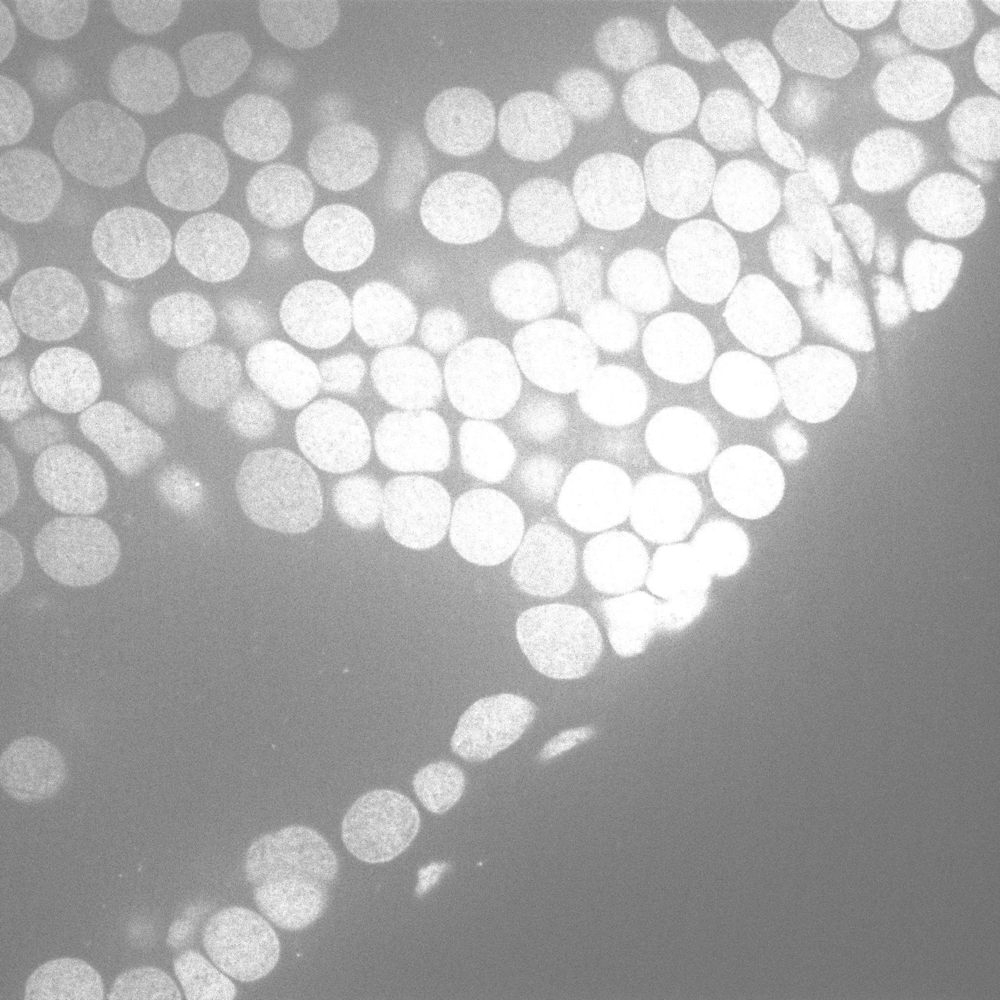

In [12]:
# take a look at the tform items
pretty_tforms = json.dumps(tform.asdict(), indent = 1)
print(pretty_tforms)
# best way to viz results is by a gif between two of the same slices
from exm.io.io import saveGif
saveGif(fix_vol[50,:,:], result[50,:,:], 'tmp.gif')

We can achieve this in two lines by doing the following:

In [13]:
from exm.engine.runner import Runner
run = Runner()
# remember we modified cfg to have our paths, fov, and num iterations
tform, result = run.runAlign(cfg)

{
 "CenterOfRotationPoint": [
  "1663.19",
  "1663.19",
  "436"
 ],
 "CompressResultImage": [
  "false"
 ],
 "ComputeZYX": [
  "false"
 ],
 "DefaultPixelValue": [
  "0.0"
 ],
 "Direction": [
  "1",
  "0",
  "0",
  "0",
  "1",
  "0",
  "0",
  "0",
  "1"
 ],
 "FinalBSplineInterpolationOrder": [
  "1"
 ],
 "FixedImageDimension": [
  "3"
 ],
 "FixedInternalImagePixelType": [
  "float"
 ],
 "HowToCombineTransforms": [
  "Compose"
 ],
 "Index": [
  "0",
  "0",
  "0"
 ],
 "InitialTransformParametersFileName": [
  "NoInitialTransform"
 ],
 "MovingImageDimension": [
  "3"
 ],
 "MovingInternalImagePixelType": [
  "float"
 ],
 "NumberOfParameters": [
  "6"
 ],
 "Origin": [
  "0",
  "0",
  "0"
 ],
 "ResampleInterpolator": [
  "FinalBSplineInterpolator"
 ],
 "Resampler": [
  "DefaultResampler"
 ],
 "ResultImageFormat": [
  "nii"
 ],
 "ResultImagePixelType": [
  "float"
 ],
 "Size": [
  "2048",
  "2048",
  "219"
 ],
 "Spacing": [
  "1.625",
  "1.625",
  "4"
 ],
 "Transform": [
  "EulerTransform"
 ],

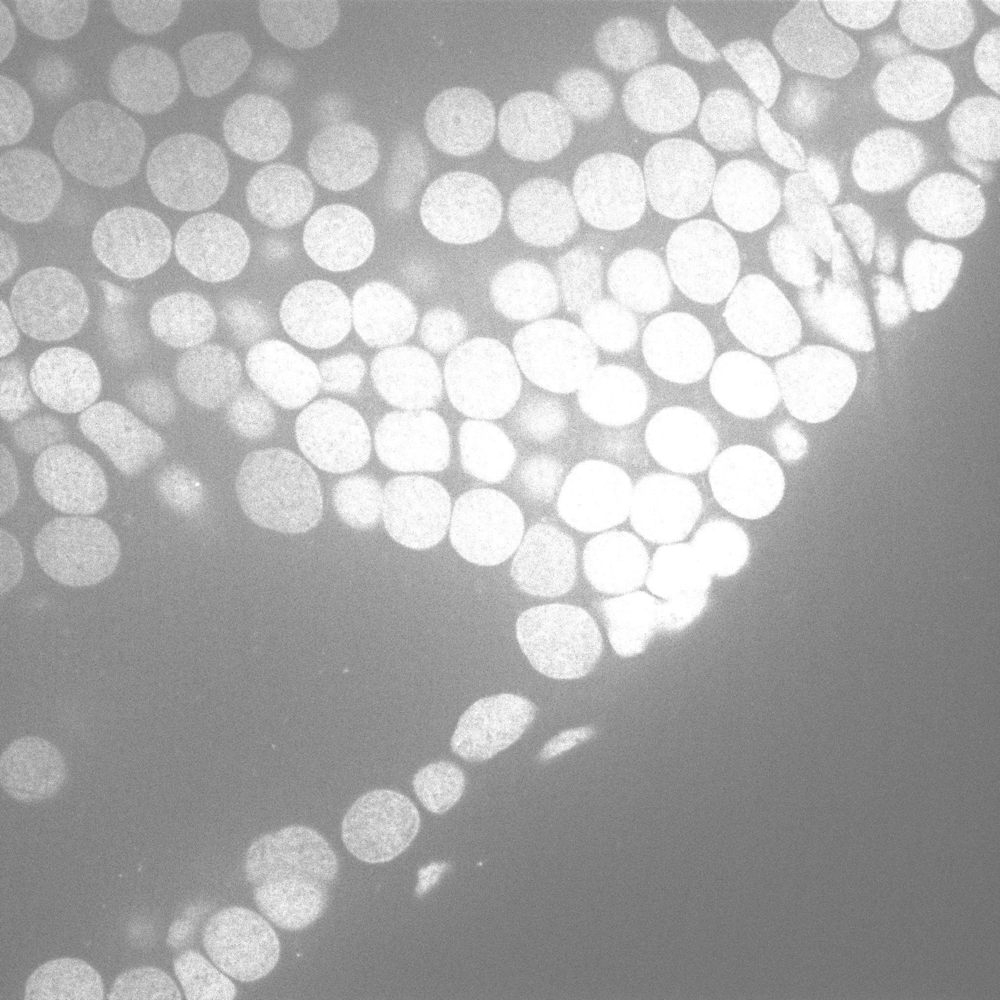

In [14]:
# take a look at the tform items
pretty_tforms = json.dumps(tform.asdict(), indent = 1)
print(pretty_tforms)
# best way to viz results is by a gif between two of the same slices
saveGif(fix_vol[50,:,:], result[50,:,:], 'tmp.gif')

So all in all the simply need these lines of code to run rigid alignment:

In [ ]:
from exm.config.utils import load_cfg
from exm.engine.runner import Runner

#get config file
cfg = load_cfg()

#defrost to add vol paths and fov
cfg.defrost()

cfg.DATASET.VOL_FIX_PATH = '/mp/nas2/ruihan/20220512/20220512_Code3/Channel405 SD_Seq0004.nd2'
cfg.DATASET.VOL_MOVE_PATH = '/mp/nas2/ruihan/20220512/20220512_Code5/Channel405 SD_Seq0004.nd2'
cfg.DATASET.FOV = 23
#change num of iterations in elastix to 250 for speed
cfg.ALIGN.MaximumNumberOfIterations = '250'

cfg.freeze()
# init runner obj and run align

run = Runner()
tform, result = run.runAlign(cfg)

{
 "CenterOfRotationPoint": [
  "1663.19",
  "1663.19",
  "436"
 ],
 "CompressResultImage": [
  "false"
 ],
 "ComputeZYX": [
  "false"
 ],
 "DefaultPixelValue": [
  "0.0"
 ],
 "Direction": [
  "1",
  "0",
  "0",
  "0",
  "1",
  "0",
  "0",
  "0",
  "1"
 ],
 "FinalBSplineInterpolationOrder": [
  "1"
 ],
 "FixedImageDimension": [
  "3"
 ],
 "FixedInternalImagePixelType": [
  "float"
 ],
 "HowToCombineTransforms": [
  "Compose"
 ],
 "Index": [
  "0",
  "0",
  "0"
 ],
 "InitialTransformParametersFileName": [
  "NoInitialTransform"
 ],
 "MovingImageDimension": [
  "3"
 ],
 "MovingInternalImagePixelType": [
  "float"
 ],
 "NumberOfParameters": [
  "6"
 ],
 "Origin": [
  "0",
  "0",
  "0"
 ],
 "ResampleInterpolator": [
  "FinalBSplineInterpolator"
 ],
 "Resampler": [
  "DefaultResampler"
 ],
 "ResultImageFormat": [
  "nii"
 ],
 "ResultImagePixelType": [
  "float"
 ],
 "Size": [
  "2048",
  "2048",
  "219"
 ],
 "Spacing": [
  "1.625",
  "1.625",
  "4"
 ],
 "Transform": [
  "EulerTransform"
 ],

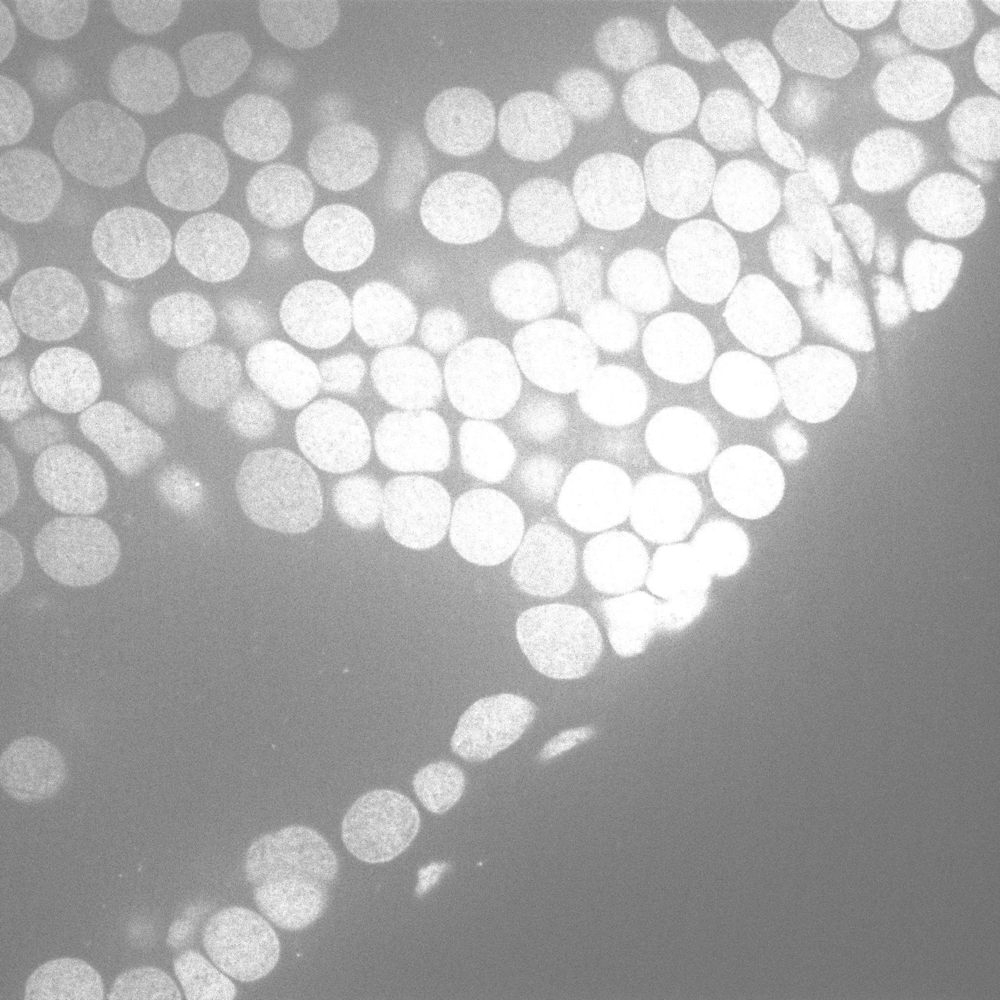

In [15]:
# take a look at the tform items
pretty_tforms = json.dumps(tform.asdict(), indent = 1)
print(pretty_tforms)
# best way to viz results is by a gif between two of the same slices
saveGif(fix_vol[50,:,:], result[50,:,:], 'tmp.gif')

Ain't that nice? 

In principle, Runner is actually a bad idea. This is becuase we perform io, computation, and if we wanted even saving all in the same object. Most biologists would like things this way (i.e. a simple one stop shop to feed in data and get results), but it is often better to grant that through a GUI instead of code. So in the next tutorial we will work with the parameter maps, the alignBuild object, and show how it has several features that can help deal with common errors. 
